# Simulation using Concord

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import scanpy as sc
import time
from pathlib import Path
import torch
import concord as ccd
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt

from matplotlib import font_manager, rcParams
custom_rc = {
    'font.family': 'Arial',  # Set the desired font for this plot
}

mpl.rcParams['svg.fonttype'] = 'none'
mpl.rcParams['pdf.fonttype'] = 42

In [3]:
proj_name = "simulation_cluster_imbalancep1"
save_dir = f"../save/dev_{proj_name}-{time.strftime('%b%d')}/"
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)

data_dir = f"../data/{proj_name}/"
data_dir = Path(data_dir)
data_dir.mkdir(parents=True, exist_ok=True)
device = torch.device('cuda:3' if torch.cuda.is_available() else 'cpu')
print(device)
seed = 0
ccd.ul.set_seed(seed)

file_suffix = f"{time.strftime('%b%d-%H%M')}"
file_suffix

cpu


'Aug11-1930'

In [17]:
concord_methods = ['concord_hcl', 'concord_knn']
other_methods = [
        "unintegrated",
        "scanorama", "liger", "harmony",
        "scvi",  'contrastive'
]
run_methods =  other_methods + concord_methods
# exclude ["UMAP", "t-SNE"] from run_method, and save as combined_keys
exclude_keys = ["PCA", "UMAP", "t-SNE"]
combined_keys = ['no_noise', 'wt_noise'] + [key for key in run_methods if key not in exclude_keys]

In [7]:
state_key = 'cluster'
batch_key = 'batch'
state_type = 'cluster'
leiden_key='leiden'
BATCH_TYPE = 'batch_specific_features'
DISTRIBUTION = 'normal'
DISPERSION = 7.0
MEAN_LEVEL = 10.0

In [66]:
import numpy as np
import anndata as ad
from concord.simulation import Simulation, SimConfig, ClusterConfig, BatchConfig
from concord.utils.anndata_utils import ordered_concat

def simulate_imbalanced_batches(
    total_cells=5000,
    total_genes=3000,
    imbalance_ratios=[1, 2, 5, 10, 20],
    mean_level=10.0,
    distribution='normal',
    dispersion=5.0,
    seed_base=42,
) -> dict:
    """
    Simulate datasets with the same cluster structure but varying batch size imbalance.
    
    Returns:
        dict mapping imbalance ratio to simulated AnnData object
    """
    adata_dict = {}

    for i, ratio in enumerate(imbalance_ratios):
        # Compute cell proportions
        p_b = 1 / (1 + ratio)    # smaller batch
        p_a = 1 - p_b            # larger batch
        cell_props = [p_a, p_b]
        cell_counts = [int(p * total_cells) for p in cell_props]
        cell_counts[-1] += total_cells - sum(cell_counts)  # fix rounding

        print(f"Simulating imbalance {ratio}: Batch sizes = {cell_counts}")

        # Config for simulation
        sim_cfg = SimConfig(
            n_cells=total_cells,
            n_genes=total_genes,
            seed=seed_base + i,
            non_neg=True,
            to_int=True,
        )

        state_cfg = ClusterConfig(
            n_states=5,
            program_structure="uniform",
            program_on_time_fraction=0.4,
            global_non_specific_gene_fraction=0.05,
            dispersion=dispersion,
            distribution=distribution,
            level=mean_level,
        )

        batch_cfg = BatchConfig(
            n_batches=2,
            effect_type=["batch_specific_features", "batch_specific_features"],
            distribution=distribution,
            level=mean_level,
            dispersion=dispersion,
            feature_frac=0.1,
            cell_proportion=cell_props,
        )

        # Run simulation
        sim = Simulation(sim_cfg, state_cfg, batch_cfg)
        adata, adata_pre = sim.simulate_data()
        adata.obs["imbalance_ratio"] = str(ratio)
        adata_dict[ratio] = adata

    return adata_dict


In [67]:
adata_dict = simulate_imbalanced_batches(
    total_cells=2000,
    total_genes=1000,
    imbalance_ratios=[1, 5, 20],
    mean_level=MEAN_LEVEL,
    distribution=DISTRIBUTION,
    dispersion=DISPERSION,
    seed_base=seed
)

Simulating imbalance 1: Batch sizes = [1000, 1000]
Simulating imbalance 5: Batch sizes = [1666, 334]
Simulating imbalance 20: Batch sizes = [1904, 96]


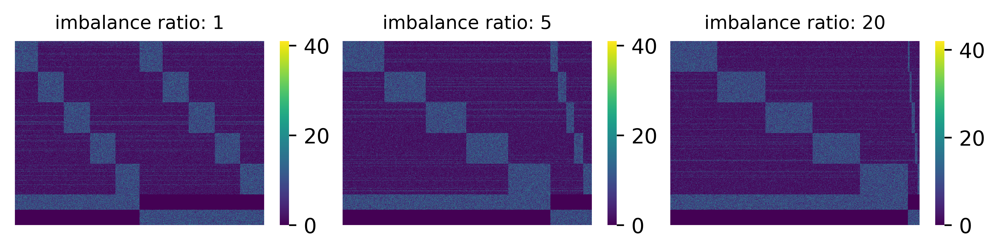

In [68]:
import matplotlib.pyplot as plt
figsize = (2.3, 1.8)
ncols = len(adata_dict)
title_fontsize = 9
dpi = 600
fig, axes = plt.subplots(1, ncols, figsize=(figsize[0] * ncols, figsize[1]), dpi=dpi)
for i, (ratio, adata) in enumerate(adata_dict.items()):
    ccd.pl.heatmap_with_annotations(adata, val='X', obs_keys=[state_key, batch_key], ax = axes[i], use_clustermap=False, yticklabels=False, cluster_cols=False, cluster_rows=False, value_annot=False, cmap='viridis', title=f"imbalance ratio: {ratio}", save_path=None, figsize=figsize, dpi=dpi, title_fontsize=title_fontsize)
plt.tight_layout(w_pad=0.0, h_pad=0.1)
plt.savefig(save_dir / f"data_heatmaps_{file_suffix}.svg", dpi=dpi, bbox_inches='tight')

### Integration pipeline

In [ ]:
run_methods = concord_methods + other_methods
#run_methods = concord_methods
latent_dim = 30

In [ ]:
concord_kwargs = {
    'batch_size': 32,
    'n_epochs': 20,
    'preload_dense': True,
    'verbose': False,
}
for i, (ratio, adata) in enumerate(adata_dict.items()):
    print(f"Processing imbalance ratio: {ratio}")
    ccd.ul.run_pca(adata, source_key='no_noise', result_key='PCA_no_noise', n_pc=latent_dim, random_state=seed)
    ccd.ul.run_pca(adata, source_key='wt_noise', result_key='PCA_wt_noise', n_pc=latent_dim, random_state=seed)
    # Put the PCA result in the adata object, so only one object is needed
    adata.obsm['no_noise'] = adata.obsm['PCA_no_noise']
    adata.obsm['wt_noise'] = adata.obsm['PCA_wt_noise']
    # sc.pp.pca(adata, n_comps=latent_dim, random_state=seed)

    profile_logs = ccd.bm.run_integration_methods_pipeline(
        adata=adata,                          
        methods=run_methods,            # List of methods to run
        batch_key=batch_key,                    # Column in adata.obs for batch info
        count_layer="counts",                 # Layer name containing raw counts
        class_key=state_key,               # Column in adata.obs for class labels (used in SCANVI and CONCORD variants)
        latent_dim=latent_dim,                        # Latent dimensionality for PCA and embeddings
        device="cpu",                        # Or "cpu", or "mps" for Apple Silicon
        return_corrected=False,                   # Whether to store corrected expression matrices
        transform_batch=None,                 # Optionally specify a batch to transform to in scVI
        seed=seed,                              # Random seed for reproducibility
        compute_umap=False,                        # Run UMAP for all output embeddings
        umap_n_components=2,
        umap_n_neighbors=30,
        umap_min_dist=0.5,
        verbose=True,                        # Print progress messages
        save_dir=save_dir,
        concord_kwargs=concord_kwargs,
    )


In [11]:
for i, (ratio, adata) in enumerate(adata_dict.items()):
    print(f"Processing imbalance ratio: {ratio}")
    for basis in combined_keys:
        print("Running UMAP for", basis)
        #if 'UMAP' not in basis:
        ccd.ul.run_umap(adata, source_key=basis, result_key=f'{basis}_UMAP', n_components=2, n_neighbors=30, min_dist=0.5, metric='euclidean', random_state=seed)

Processing imbalance ratio: 1
Running UMAP for concord_hcl


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


Running UMAP for concord_knn
Running UMAP for contrastive
Processing imbalance ratio: 5
Running UMAP for concord_hcl
Running UMAP for concord_knn
Running UMAP for contrastive
Processing imbalance ratio: 20
Running UMAP for concord_hcl
Running UMAP for concord_knn
Running UMAP for contrastive


Processing imbalance ratio: 1


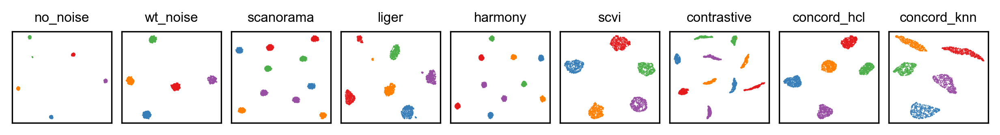

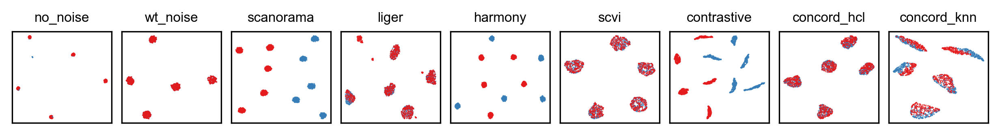

Processing imbalance ratio: 5


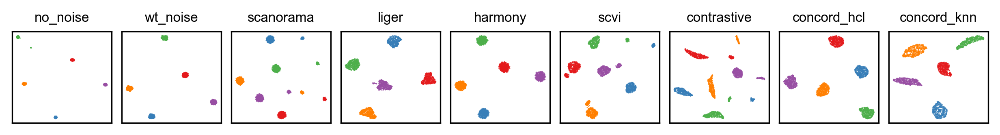

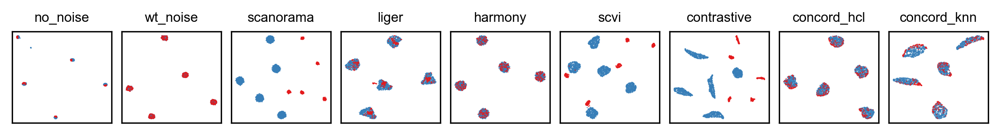

Processing imbalance ratio: 20


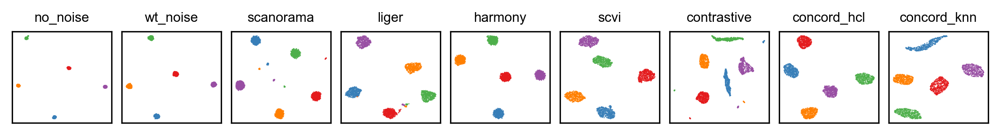

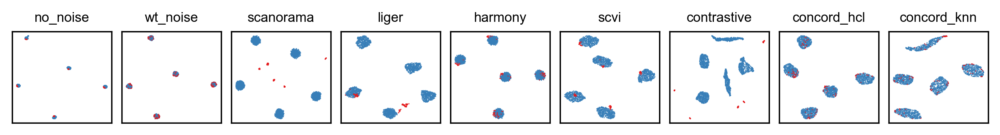

In [18]:
# plot everything
import matplotlib.pyplot as plt

show_keys = [key for key in combined_keys if key != 'unintegrated']
# check which methods are run successfully
color_bys = [state_key, batch_key]
basis_types = ['UMAP']
#basis_types = ['KNN']
font_size=8
point_size=2
alpha=0.8
figsize=(0.9*len(show_keys),1)
ncols = len(show_keys)
nrows = int(np.ceil(len(show_keys) / ncols))
pal = {'time':'viridis', 'batch':'Set1'}
k=15
edges_color='grey'
edges_width=0
layout='kk'
threshold = 0.1
node_size_scale=0.1
edge_width_scale=0.1

rasterized = True

for i, (ratio, adata) in enumerate(adata_dict.items()):
    print(f"Processing imbalance ratio: {ratio}")

    with plt.rc_context(rc=custom_rc):
        ccd.pl.plot_all_embeddings(
            adata,
            show_keys,
            color_bys=color_bys,
            basis_types=basis_types,
            pal=pal,
            k=k,
            edges_color=edges_color,
            edges_width=edges_width,
            layout=layout,
            threshold=threshold,
            node_size_scale=node_size_scale,
            edge_width_scale=edge_width_scale,
            font_size=font_size,
            point_size=point_size,
            alpha=alpha,
            rasterized=rasterized,
            figsize=figsize,
            ncols=ncols,
            seed=seed,
            leiden_key='leiden',
            save_dir=save_dir,
            file_suffix=file_suffix+ f"_{ratio}",
            save_format='svg'
        )


In [76]:
# Save adata_dict to file
import pickle
with open(save_dir / f"adata_dict_{file_suffix}.pkl", 'wb') as f:
    pickle.dump(adata_dict, f)  

print(f"Saved adata_dict to {save_dir / f'adata_dict_{file_suffix}.pkl'}")

Saved adata_dict to ../save/dev_simulation_cluster_imbalancep1-Jul26/adata_dict_Jul26-1919.pkl


Processing imbalance ratio: 1 with 2000 cells and 1200 genes
Processing imbalance ratio: 5 with 1999 cells and 1200 genes
Processing imbalance ratio: 20 with 1999 cells and 1200 genes


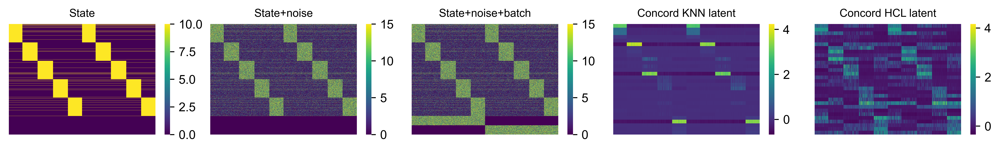

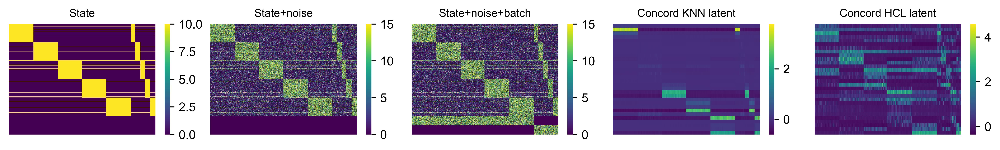

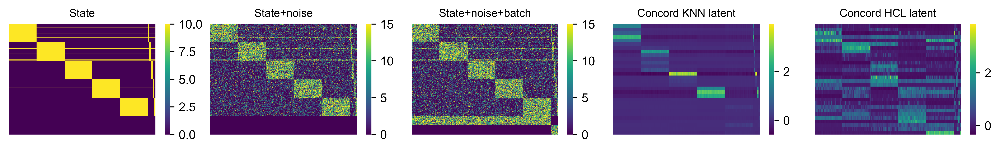

In [8]:
# Plot heatmap of original data and Concord latent
import matplotlib.pyplot as plt
figsize = (2.3, 1.8)
ncols = 5
title_fontsize = 9
for i, (ratio, adata) in enumerate(adata_dict.items()):
    print(f"Processing imbalance ratio: {ratio} with {len(adata.obs)} cells and {len(adata.var)} genes")
    batch_id=adata.obs['batch'].unique()[0]
    batch_indices = np.where(adata.obs['batch'] == batch_id)[0]
    _, _, _, feature_order = ccd.ul.sort_and_smooth_signal_along_path(adata, signal_key='concord_knn', path=batch_indices, sigma=2)
    adata.obsm['concord_knn_sorted'] = adata.obsm['concord_knn'][:, feature_order]
    _, _, _, feature_order = ccd.ul.sort_and_smooth_signal_along_path(adata, signal_key='concord_hcl', path=batch_indices, sigma=2)
    adata.obsm['concord_hcl_sorted'] = adata.obsm['concord_hcl'][:, feature_order]
    # Run concord latent
    _, _, state_pal = ccd.pl.get_color_mapping(adata, state_key, pal='Paired', seed=seed)
    _, _, batch_pal = ccd.pl.get_color_mapping(adata, batch_key, pal='Set1', seed=seed)
    pal = {state_key: state_pal, batch_key: batch_pal}
    dpi = 600
    with plt.rc_context(rc=custom_rc):
        fig, axes = plt.subplots(1, ncols, figsize=(figsize[0] * ncols, figsize[1]), dpi=dpi)
        ccd.pl.heatmap_with_annotations(adata, val='no_noise', obs_keys=[state_key], ax = axes[0], use_clustermap=False, pal=pal, yticklabels=False, cluster_cols=False, cluster_rows=False, value_annot=False, cmap='viridis', title='State', save_path=None, figsize=figsize, dpi=dpi, title_fontsize=title_fontsize)
        ccd.pl.heatmap_with_annotations(adata, val='wt_noise', vmax=15, obs_keys=[state_key], ax = axes[1], use_clustermap=False, pal=pal, yticklabels=False, cluster_cols=False, cluster_rows=False, value_annot=False, cmap='viridis', title='State+noise', save_path=None, figsize=figsize, dpi=dpi, title_fontsize=title_fontsize)
        ccd.pl.heatmap_with_annotations(adata, val='X', vmax=15, obs_keys=[state_key, batch_key], ax = axes[2], use_clustermap=False, pal=pal, yticklabels=False, cluster_cols=False, cluster_rows=False, value_annot=False, cmap='viridis', title='State+noise+batch', save_path=None, figsize=figsize, dpi=dpi, title_fontsize=title_fontsize)
        ccd.pl.heatmap_with_annotations(adata, val='concord_knn_sorted', obs_keys=[state_key, batch_key], ax = axes[3], use_clustermap=False, pal=pal, yticklabels=False, cluster_cols=False, cluster_rows=False, value_annot=False, cmap='viridis', title='Concord KNN latent', save_path=None, figsize=figsize, dpi=dpi, title_fontsize=title_fontsize)
        ccd.pl.heatmap_with_annotations(adata, val='concord_hcl_sorted', obs_keys=[state_key, batch_key], ax = axes[4], use_clustermap=False, pal=pal, yticklabels=False, cluster_cols=False, cluster_rows=False, value_annot=False, cmap='viridis', title='Concord HCL latent', save_path=None, figsize=figsize, dpi=dpi, title_fontsize=title_fontsize)
        plt.tight_layout(w_pad=0.0, h_pad=0.1)
        plt.savefig(save_dir / f"all_heatmaps_{ratio}_{file_suffix}.svg", dpi=dpi, bbox_inches='tight')

# Evaluation

In [13]:
# Load adata_dict from file
import pickle
with open(Path('../save/dev_simulation_cluster_imbalancep1-Jul26/adata_dict_Jul26-1919.pkl'), 'rb') as f:
    adata_dict = pickle.load(f) 

concord - INFO - Running SCIB benchmark


Embeddings: 100%|██████████| 10/10 [00:10<00:00,  1.07s/it]


concord - INFO - Running Probe benchmark
Detected task: classification
[KNN] detected task: classification
concord - INFO - Computing cell distance correlation
concord - INFO - Computing trustworthiness
concord - INFO - Computing state dispersion correlation
concord - INFO - Saved full geometry benchmark results to ../save/dev_simulation_cluster_imbalancep1-Jul29/benchmarks_out/geometry_results_Jul29-1352_1.pkl


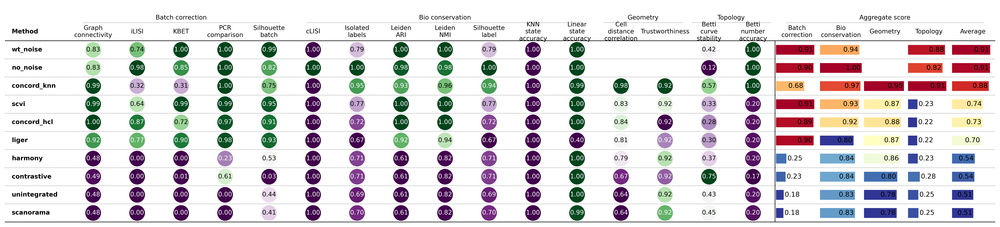

concord - INFO - Saved benchmark results to ../save/dev_simulation_cluster_imbalancep1-Jul29/benchmarks_out/benchmark_results_Jul29-1352_1.pkl
concord - INFO - Running SCIB benchmark


Embeddings: 100%|██████████| 10/10 [00:10<00:00,  1.10s/it]


concord - INFO - Running Probe benchmark
Detected task: classification
[KNN] detected task: classification
concord - INFO - Computing cell distance correlation
concord - INFO - Computing trustworthiness
concord - INFO - Computing state dispersion correlation
concord - INFO - Saved full geometry benchmark results to ../save/dev_simulation_cluster_imbalancep1-Jul29/benchmarks_out/geometry_results_Jul29-1352_5.pkl


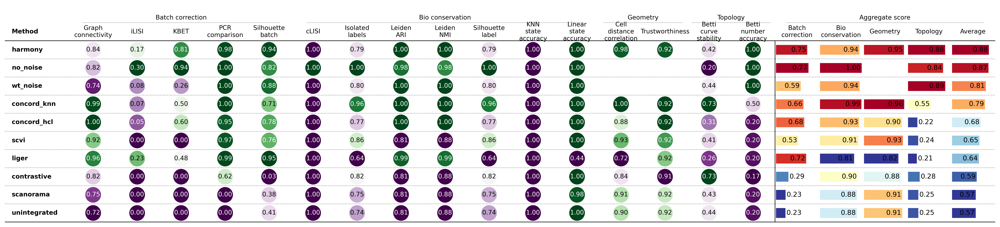

concord - INFO - Saved benchmark results to ../save/dev_simulation_cluster_imbalancep1-Jul29/benchmarks_out/benchmark_results_Jul29-1352_5.pkl
concord - INFO - Running SCIB benchmark


Embeddings: 100%|██████████| 10/10 [00:09<00:00,  1.03it/s]


concord - INFO - Running Probe benchmark
Detected task: classification
[KNN] detected task: classification
concord - INFO - Computing cell distance correlation
concord - INFO - Computing trustworthiness
concord - INFO - Computing state dispersion correlation
concord - INFO - Saved full geometry benchmark results to ../save/dev_simulation_cluster_imbalancep1-Jul29/benchmarks_out/geometry_results_Jul29-1352_20.pkl


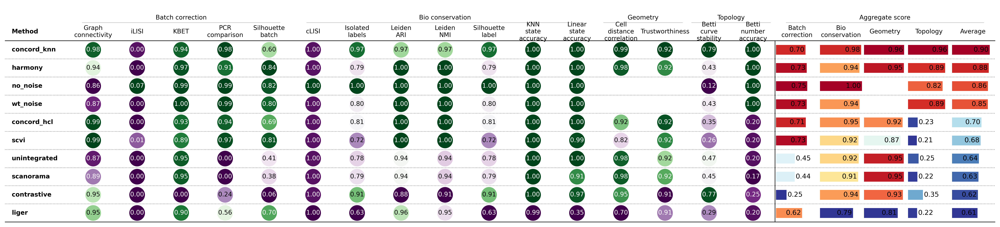

concord - INFO - Saved benchmark results to ../save/dev_simulation_cluster_imbalancep1-Jul29/benchmarks_out/benchmark_results_Jul29-1352_20.pkl


In [17]:
bm_results = {}
for i, (ratio, adata) in enumerate(adata_dict.items()):
    out = ccd.bm.run_benchmark_pipeline(
        adata,
        embedding_keys=combined_keys,
        state_key=state_key,
        batch_key=batch_key,
        groundtruth_key="no_noise",  # use the Leiden clusters as ground truth
        save_dir=save_dir / "benchmarks_out",
        run=("scib", "probe", "geometry", "topology"),          # run only these blocks
        plot_individual=False,          # skip the intermediate PDFs
        expected_betti_numbers=[4,0,0],  # expected Betti numbers for the geometry and topology blocks
        max_points=1000,
        file_suffix=f"{file_suffix}_{ratio}",  # suffix for the output files
        seed=seed,  # for reproducibility
    )
    bm_results[ratio] = out  # Store the results for this imbalance ratio
    combined = out["combined"]

In [81]:
# Save benchmark results
import pickle
with open(save_dir / f"benchmark_results_{file_suffix}.pkl", 'wb') as f:
    pickle.dump(bm_results, f)

print(f"Saved benchmark results to {save_dir / f'benchmark_results_{file_suffix}.pkl'}")

Saved benchmark results to ../save/dev_simulation_cluster_imbalancep1-Jul26/benchmark_results_Jul26-1919.pkl


Imbalance ratio: 1


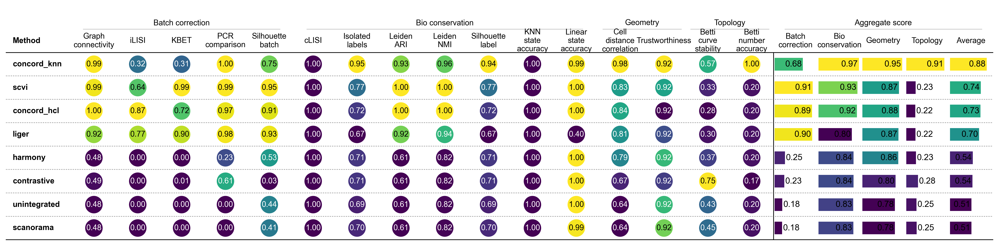

Imbalance ratio: 5


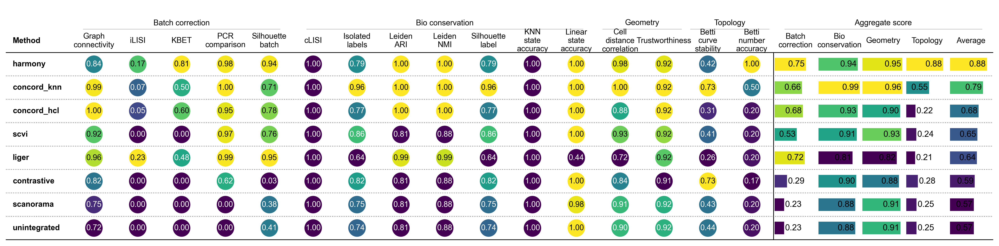

Imbalance ratio: 20


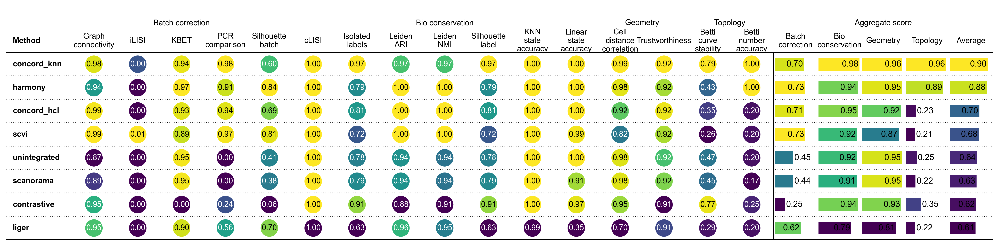

In [82]:
# Load benchmark results
import pickle
bm_results = pickle.load(open(Path('../save/dev_simulation_cluster_imbalancep1-Jul26/benchmark_results_Jul26-1919.pkl'), "rb"))

for ratio, out in bm_results.items():
    print(f"Imbalance ratio: {ratio}")
    table_plot_kw = dict(
            pal="viridis", pal_agg="viridis", cmap_method="minmax", dpi=300)
    with plt.rc_context(rc=custom_rc):
        combined_df = ccd.bm.combine_benchmark_results(
            out,
            block_include=("geometry", "topology", "scib", "probe"),
            plot=False,
            save_path=save_dir / f"combined_res_{file_suffix}.pdf",
            table_plot_kw=table_plot_kw,
        )
        ccd.bm.plot_benchmark_table(
                combined_df.dropna(axis=0, how='any'),
                save_path=save_dir / f"benchmark_table_{file_suffix}.svg",
                agg_name="Aggregate score",
                figsize=(25, 6),
                **table_plot_kw
                )